In [1]:
import pandas as pd
import numpy as np
import glob
import warnings
import missingno as msno
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import os
warnings.filterwarnings('ignore')

In [2]:
from fancyimpute import IterativeImputer

# Importing the dataset

In [3]:
#Importing the DatasetIII 
path = r"C:\Users\mg22322\EyeT\EyeT_group_dataset_III_image_name_letter_card_participant_**_trial_*.csv"
filename = glob.glob(path)
df_pre= []
for file in filename:
    df_pre.append(pd.read_csv(file))
df = pd.concat(df_pre, ignore_index=True)

In [4]:
df.head()

,Unnamed: 0,Recording timestamp,Computer timestamp,Sensor,Project name,Export date,Participant name,Recording name,Recording date,Recording date UTC,...,Original Media height,Eye movement type,Gaze event duration,Eye movement type index,Fixation point X,Fixation point Y,Fixation point X (MCSnorm),Fixation point Y (MCSnorm),Mouse position X,Mouse position Y
0,3082,23419315,512092386,NaN,Test group experiment,29.10.2020,Participant0001,Recording1,24.09.2020,24.09.2020,...,NaN,Fixation,117.0,64.0,971.0,341.0,"0,5073","0,3160",NaN,NaN
1,3083,23419315,512092386,NaN,Test group experiment,29.10.2020,Participant0001,Recording1,24.09.2020,24.09.2020,...,NaN,Fixation,117.0,64.0,971.0,341.0,"0,5073","0,3160",NaN,NaN
2,3084,23426120,512099191,Eye Tracker,Test group experiment,29.10.2020,Participant0001,Recording1,24.09.2020,24.09.2020,...,649.0,Fixation,117.0,64.0,971.0,341.0,"0,5073","0,3160",NaN,NaN
3,3085,23434449,512107520,Eye Tracker,Test group experiment,29.10.2020,Participant0001,Recording1,24.09.2020,24.09.2020,...,649.0,Fixation,117.0,64.0,971.0,341.0,"0,5073","0,3160",NaN,NaN
4,3086,23442782,512115853,Eye Tracker,Test group experiment,29.10.2020,Participant0001,Recording1,24.09.2020,24.09.2020,...,649.0,Fixation,117.0,64.0,971.0,341.0,"0,5073","0,3160",NaN,NaN


In [5]:
df.shape

(3776742, 71)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3776742 entries, 0 to 3776741
Data columns (total 71 columns):
 #   Column                               Dtype  
---  ------                               -----  
 0   Unnamed: 0                           int64  
 1   Recording timestamp                  int64  
 2   Computer timestamp                   int64  
 3   Sensor                               object 
 4   Project name                         object 
 5   Export date                          object 
 6   Participant name                     object 
 7   Recording name                       object 
 8   Recording date                       object 
 9   Recording date UTC                   object 
 10  Recording start time                 object 
 11  Recording start time UTC             object 
 12  Recording duration                   int64  
 13  Timeline name                        object 
 14  Recording Fixation filter name       object 
 15  Recording software version      

In [7]:
#Importing the Questionare dataset
df_question =pd.read_csv(r"C:\Users\mg22322\Questionnaire_datasetIB.csv", encoding = 'ISO-8859-1')


In [8]:
df_question.head()

,Participant nr,NR,Created,Modified,I have read and understood the information about the study and all the information in this form is explained to me and I am willing to participate,I want to participate.,I sometimes find it difficult to see things from the other guys point of view.,"I am usually objective when I watch a film or play, and I dont often get completely caught up in it.",I try to look at everybodys side of a disagreement before I make a decision.,I sometimes try to understand my friends better by imagining how things look from their perspective.,...,"If someone is suffering from stutter, I prefer speaking rather than texting.",I try to be patient when people speak with me very slowly.,"In a situation, when there are handicapped students in a classroom, the pace of the class should be adapted to the handicapped student.","In a situation, when there are only one handicapped student in a classroom, the pace of the class should be adapted to him/her independently of how many students are in the class.","I feel impatient when people communicate slowly, so I complete other peoples sentences to make the communication more efficient.",I believe that the handicapped students should catch the pace of the group in a classroom to not delay the progress of other students.,I feel left out (or excluded) when I cannot participate in a conversation.,Total Score extended,Total Score original,Elapsed time
0,1,9534500,24.09.2020 16:00,24.09.2020 16:00,Yes,Proceed,1,3,4,4,...,1,4,4,4,1,2,4,137,109,5 minutes 5 seconds
1,2,9597659,30.09.2020 15:14,30.09.2020 15:14,Yes,Proceed,2,2,4,4,...,2,4,3,3,4,2,2,127,100,5 minutes 55 seconds
2,3,9637453,01.10.2020 16:20,01.10.2020 16:20,Yes,Proceed,4,1,4,4,...,3,3,3,2,3,3,2,123,98,6 minutes 49 seconds
3,4,9732460,06.10.2020 16:45,06.10.2020 16:45,Yes,Proceed,2,3,3,3,...,2,3,4,3,2,4,2,120,95,8 minutes 39 seconds
4,5,9732853,06.10.2020 17:24,06.10.2020 17:24,Yes,Proceed,2,3,4,3,...,3,4,2,1,4,3,4,124,97,7 minutes 27 seconds


In [9]:
df_question.shape

(60, 49)

# Preprocessing

In [10]:
#Pre-Processing Dataset III
'''Removing those rows which is having missing values on Pupil diameter as pupil changes are typically much slower
   than that of eye-movements and frequency  of 40 Hz is adequate to study the time-evolution of pupil diameter'''
df = df.dropna(subset = ['Pupil diameter left','Pupil diameter right'])

In [11]:
df.shape

(801848, 71)

<AxesSubplot:>

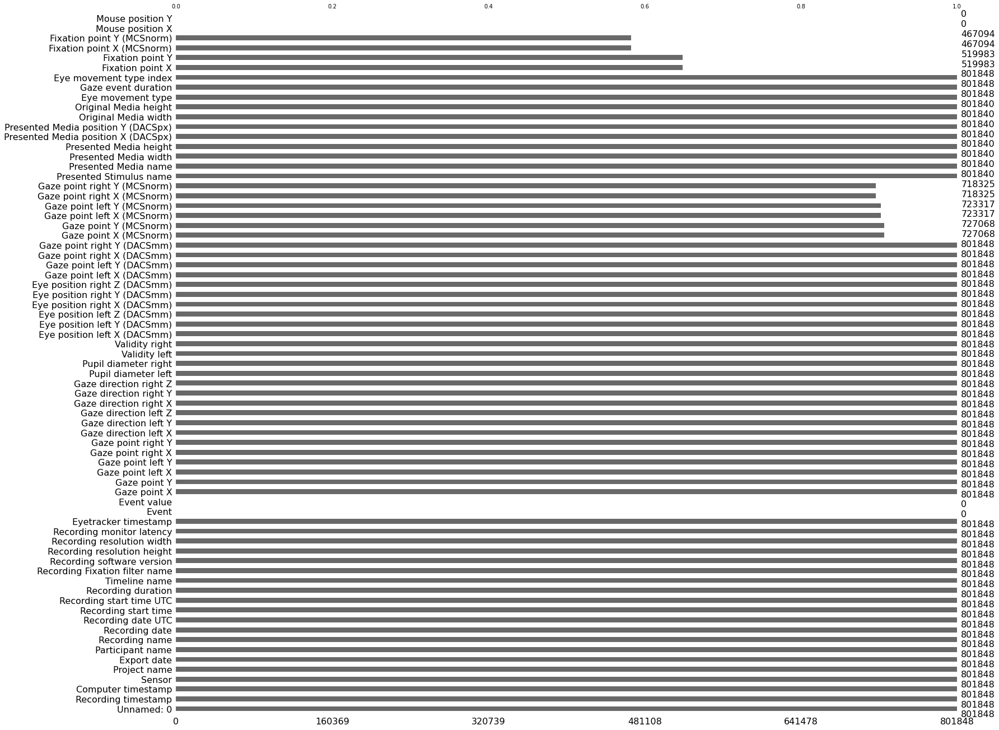

In [12]:
#Plotting missing values for each coloumsn
msno.bar(df)

Missing value plot shows that there are coloumns which are having majority of its value missing.So We are taking 75% as the threshold limits and going to remove those coloumns which are having missing values of more than 75%

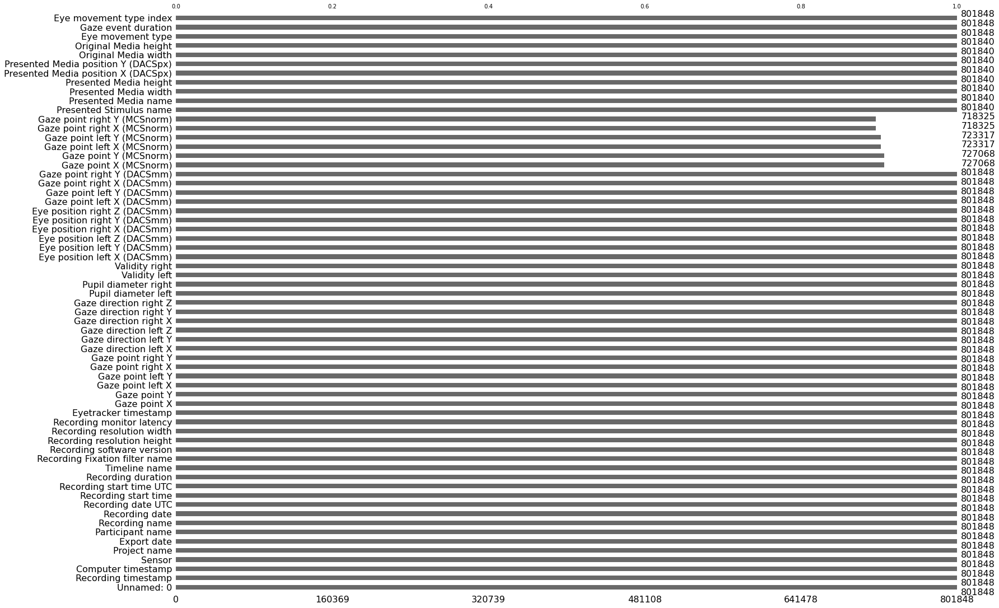

In [13]:
def coloumns_removal(df):
    '''Function to remove coloumns which are having for 75% of missing values'''
    thres = int(0.75*len(df)) # Provinding 75 as the threshold
    df = df.dropna(thresh=thres, axis = 1)
    msno.bar(df)
    return df

df = coloumns_removal(df)

These graphs shows that all the coloumns which had more than 75% of missing values have been removed.But It can also be observed that some coloumns still have missing values which need to be imputed 

It can also be observed that some of coloumns in the dataframe has same values throughout. Such coloumns having zero variance won't have any effect on the model, so we are removing such coloumns

In [14]:
def unique_val_cols(df):
    '''Removing Coloumns having are having same values on every rows'''
    unique_values = []
    for column in df.columns :
        if df[column].nunique() <= 1: # If columns have unique values more than 1, it means that columns have variance
            unique_values.append(column)
    df = df.drop(columns = unique_values)
    return df

df = unique_val_cols(df)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 801848 entries, 4 to 3776737
Data columns (total 51 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Unnamed: 0                     801848 non-null  int64  
 1   Recording timestamp            801848 non-null  int64  
 2   Computer timestamp             801848 non-null  int64  
 3   Project name                   801848 non-null  object 
 4   Export date                    801848 non-null  object 
 5   Participant name               801848 non-null  object 
 6   Recording name                 801848 non-null  object 
 7   Recording date                 801848 non-null  object 
 8   Recording date UTC             801848 non-null  object 
 9   Recording start time           801848 non-null  object 
 10  Recording start time UTC       801848 non-null  object 
 11  Recording duration             801848 non-null  int64  
 12  Timeline name                

It can also be observed that some coloumns that needs to be in int or float data type is in object format. On Closer obeservation of these coloumns in many ',' was instead '.' which makes the transformation into float impossible. So we need to change all the ',' into '.' .

Further there are some coloumns on the wrong format which needed to be type casted. In addition to that we can find that target coloumn which is the empathy score is missing in this dataset.

In [16]:
def numeric_conversion(df):
    '''Function to replace comma in dataset III to dot and type casting object datapoints into numerica datapoints'''
    df = df.replace(',','.',regex = True)
    for col in df.columns:
        if not pd.api.types.is_numeric_dtype(df[col]):
            df[col] = pd.to_numeric(df[col], errors='ignore')
    return df
df = numeric_conversion(df)

In [17]:
#Pre-Processing Dataset IB and merging the empathy score with Dataset III
def empathy_score(df,df_question):
    '''
       Fuction that takes empathy score which is our target variable from the questionare data set and
       it to the Dataset III.
    '''
    empathy_scores= {}
    for index, row in df_question.iterrows():
        empathy_scores[int(row['Participant nr'])] = row['Total Score extended']
    df['Participant name'] = df['Participant name'].str[-2:]
    df['Participant name'] = df['Participant name'].astype(int)
    df = df.sort_values('Participant name')
    df['Empathy Score'] = 0
    df['Empathy Score'] = df['Participant name'].apply(lambda x: empathy_scores.get(x, 0))
    return df, empathy_scores
df,empathy_scores = empathy_score(df,df_question)
df = df.sort_values('Participant name')

<AxesSubplot:>

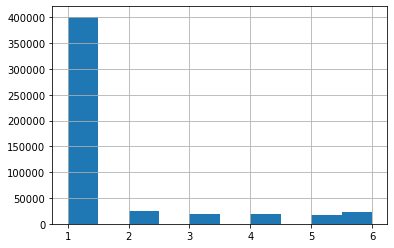

In [18]:
eyetrackertimestamp = df['Eyetracker timestamp'].value_counts(dropna=False)
eyetrackertimestamp.hist()

This graph shows that there is some issues with the recording of the data as for a particular timestamp there can only be one observation but in our dataset there are multiple entries for a some particular entries. This shows that there are presence of duplicated which need to be removed

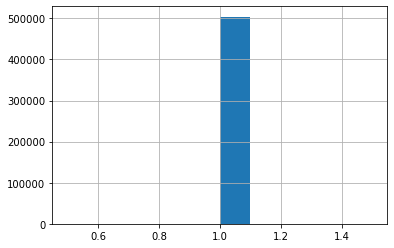

In [19]:
def removing_duplicates(df):
    '''Function to remove duplicates from the dataset considering the Eyetracker Time Stamp Coloumn'''
    df = df.drop_duplicates(subset = 'Eyetracker timestamp')
    eyetrackertimestamp = df['Eyetracker timestamp'].value_counts(dropna=False)
    eyetrackertimestamp.hist()
    return df

df = removing_duplicates(df)

Above Graph has shows us that we have removed all the datapoints which are having duplicate values based on eyetracker time stamp

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 503979 entries, 4 to 2778518
Data columns (total 52 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Unnamed: 0                     503979 non-null  int64  
 1   Recording timestamp            503979 non-null  int64  
 2   Computer timestamp             503979 non-null  int64  
 3   Project name                   503979 non-null  object 
 4   Export date                    503979 non-null  object 
 5   Participant name               503979 non-null  int32  
 6   Recording name                 503979 non-null  object 
 7   Recording date                 503979 non-null  object 
 8   Recording date UTC             503979 non-null  object 
 9   Recording start time           503979 non-null  object 
 10  Recording start time UTC       503979 non-null  object 
 11  Recording duration             503979 non-null  int64  
 12  Timeline name                

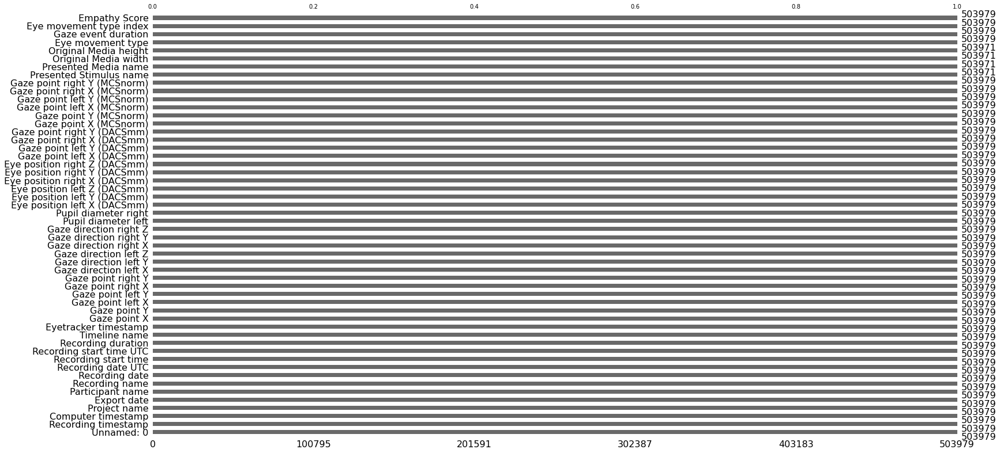

In [21]:
missing_val_columns = ['Gaze point X (MCSnorm)','Gaze point Y (MCSnorm)','Gaze point left X (MCSnorm)','Gaze point left Y (MCSnorm)','Gaze point right X (MCSnorm)','Gaze point right Y (MCSnorm)']
def missing_val_imputation(df,missing_val_columns):
    '''Function to impute the missing values on the Dataset III using K-Nearest Algorithm'''
    imputer = IterativeImputer()
    df[missing_val_columns] = imputer.fit_transform(df[missing_val_columns])
    msno.bar(df)
    return df
df = missing_val_imputation(df,missing_val_columns)

This plot shows us that all the missing values from the dataset III has been imputed

# Exploratory Data Analysis and Visualisation

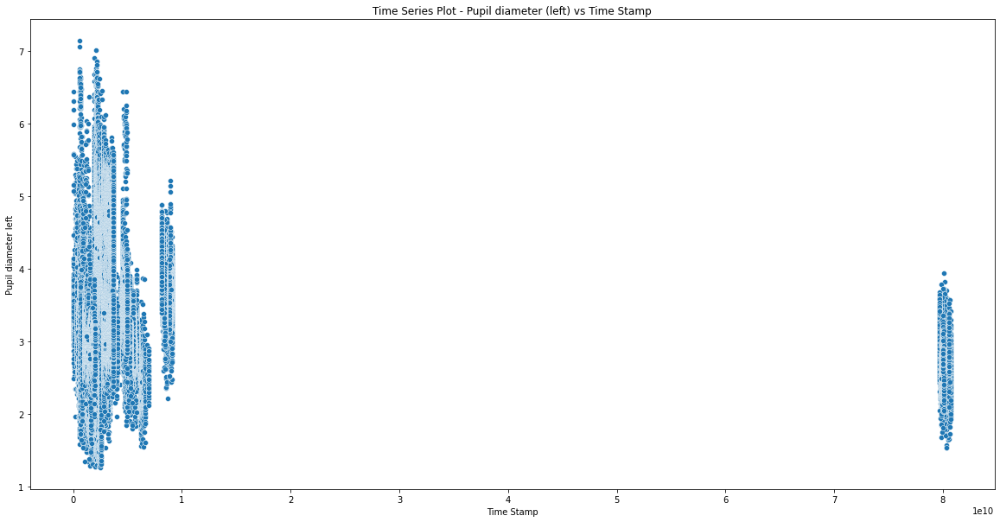

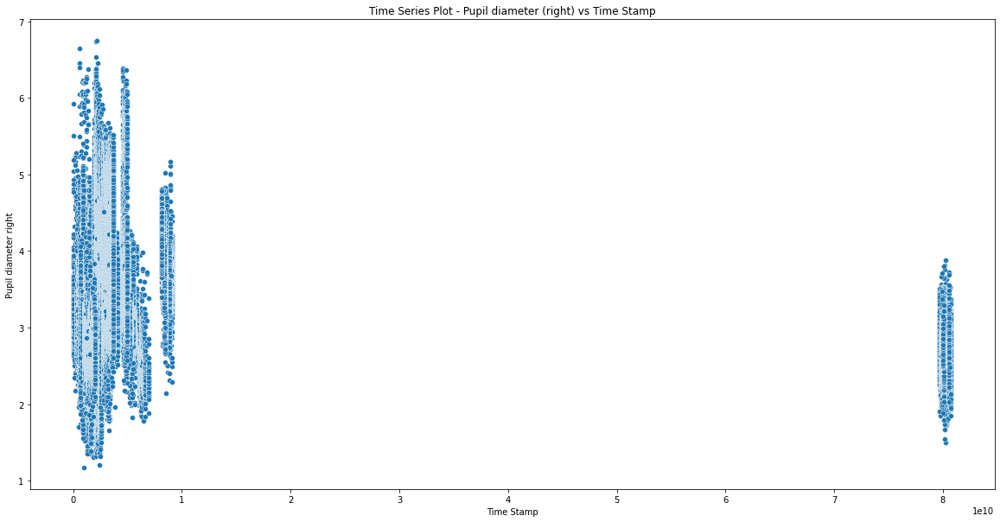

In [22]:
def time_series_plots(df):
    plt.figure(figsize=(20, 10))
    sns.scatterplot(x=df['Eyetracker timestamp'],y=df['Pupil diameter left'], data= df)
    plt.xlabel('Time Stamp')
    plt.ylabel('Pupil diameter left')
    plt.title('Time Series Plot - Pupil diameter (left) vs Time Stamp')
    plt.show()
    
    plt.figure(figsize=(20, 10))
    sns.scatterplot(x=df['Eyetracker timestamp'],y=df['Pupil diameter right'], data= df)
    plt.xlabel('Time Stamp')
    plt.ylabel('Pupil diameter right')
    plt.title('Time Series Plot - Pupil diameter (right) vs Time Stamp')
    plt.show()

time_series_plots(df)

array([[<AxesSubplot:title={'center':'Unnamed: 0'}>,
        <AxesSubplot:title={'center':'Recording timestamp'}>,
        <AxesSubplot:title={'center':'Computer timestamp'}>,
        <AxesSubplot:title={'center':'Participant name'}>,
        <AxesSubplot:title={'center':'Recording duration'}>,
        <AxesSubplot:title={'center':'Eyetracker timestamp'}>],
       [<AxesSubplot:title={'center':'Gaze point X'}>,
        <AxesSubplot:title={'center':'Gaze point Y'}>,
        <AxesSubplot:title={'center':'Gaze point left X'}>,
        <AxesSubplot:title={'center':'Gaze point left Y'}>,
        <AxesSubplot:title={'center':'Gaze point right X'}>,
        <AxesSubplot:title={'center':'Gaze point right Y'}>],
       [<AxesSubplot:title={'center':'Gaze direction left X'}>,
        <AxesSubplot:title={'center':'Gaze direction left Y'}>,
        <AxesSubplot:title={'center':'Gaze direction left Z'}>,
        <AxesSubplot:title={'center':'Gaze direction right X'}>,
        <AxesSubplot:title={'c

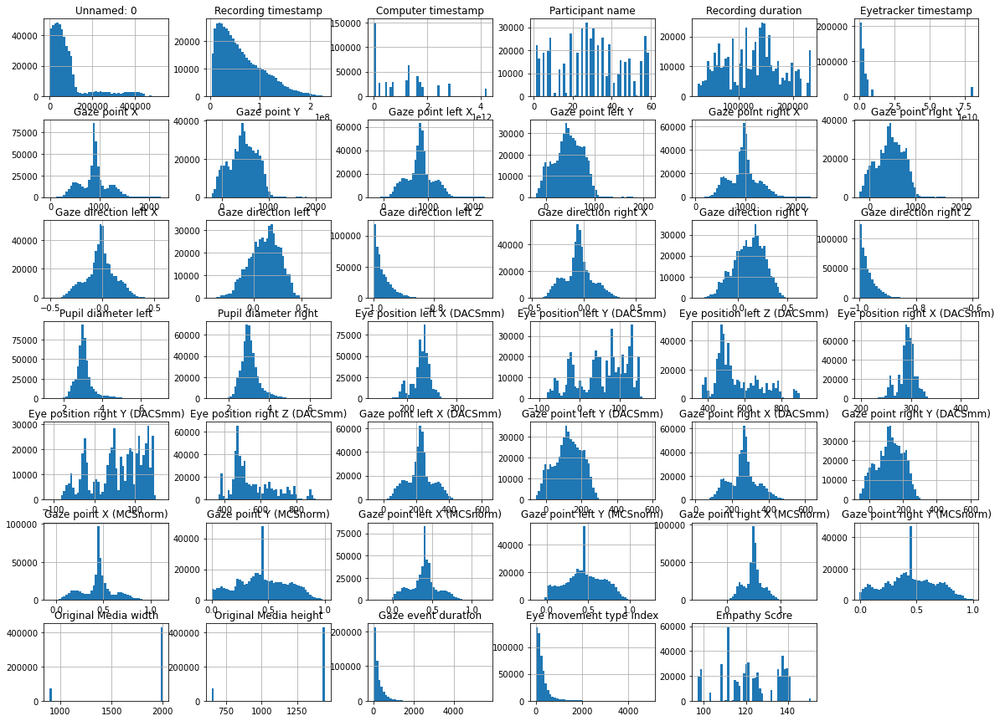

In [23]:
df.hist(bins=50, figsize=(20,15))

This plot shows the distribution of the values in each coloumns.It can be observed that there are some highly skewed due its distributions and have to be removed.

In [24]:
sns.pairplot(df)

From the above plot as well from the paper it can be concluded that Gaze event duration, Pupil diameters, Gaze points, Gaze directions, Eye Positions as the predictor variable for the model

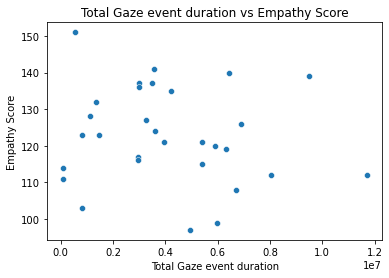

In [25]:
def gaze_event_duration(df, empathy_scores):
    gaze_event_duration = {}
    for index, row in df.iterrows():
        participant_name = row['Participant name']
        gaze_duration = row['Gaze event duration']
        if participant_name in gaze_event_duration:
            gaze_event_duration[participant_name] += gaze_duration
        else:
            gaze_event_duration[participant_name] = gaze_duration

    new_df = pd.DataFrame(gaze_event_duration.items(), columns=["Participant name", "Gaze event duration"])
    new_df['Empathy Score'] = new_df['Participant name'].apply(lambda x: empathy_scores.get(x, 0))
    sns.scatterplot(x= new_df['Gaze event duration'], y =new_df['Empathy Score'], data=new_df)
    plt.xlabel('Total Gaze event duration')
    plt.ylabel('Empathy Score')
    plt.title('Total Gaze event duration vs Empathy Score')
    plt.show()

gaze_event_duration(df, empathy_scores)


In [28]:
def record_duration(df, empathy_scores):
    total_record_duration = {}
    for index, row in df.iterrows():
        participant_name = row['Participant name']
        record_duration = row['Gaze event duration']
        if participant_name in gaze_event_duration:
            total_record_duration[participant_name] += gaze_duration
        else:
            total_record_duration[participant_name] = gaze_duration

    new_df = pd.DataFrame(total_record_duration.items(), columns=["Participant name", "Gaze event duration"])
    new_df['Empathy Score'] = new_df['Participant name'].apply(lambda x: empathy_scores.get(x, 0))
    sns.scatterplot(x= new_df['Gaze event duration'], y =new_df['Empathy Score'], data=new_df)
    plt.xlabel('Total Gaze event duration')
    plt.ylabel('Empathy Score')
    plt.title('Total Gaze event duration vs Empathy Score')
    plt.show()

record_duration(df, empathy_scores)

TypeError: argument of type 'function' is not iterable

Coloums with Corelation are -  {'Eye position right Y (DACSmm)', 'Gaze point right Y (MCSnorm)', 'Pupil diameter right', 'Gaze point right X (DACSmm)', 'Gaze point Y (MCSnorm)', 'Gaze direction left Y', 'Gaze direction right Z', 'Gaze point left X (DACSmm)', 'Gaze point X (MCSnorm)', 'Gaze point right Y (DACSmm)', 'Gaze direction left X', 'Eye position right X (DACSmm)', 'Gaze point left X', 'Gaze point left Y (MCSnorm)', 'Gaze point right X', 'Gaze point right X (MCSnorm)', 'Eye position right Z (DACSmm)', 'Gaze point right Y', 'Gaze point left Y (DACSmm)', 'Gaze point left Y', 'Original Media height', 'Gaze direction right Y', 'Gaze point left X (MCSnorm)', 'Gaze direction right X'}


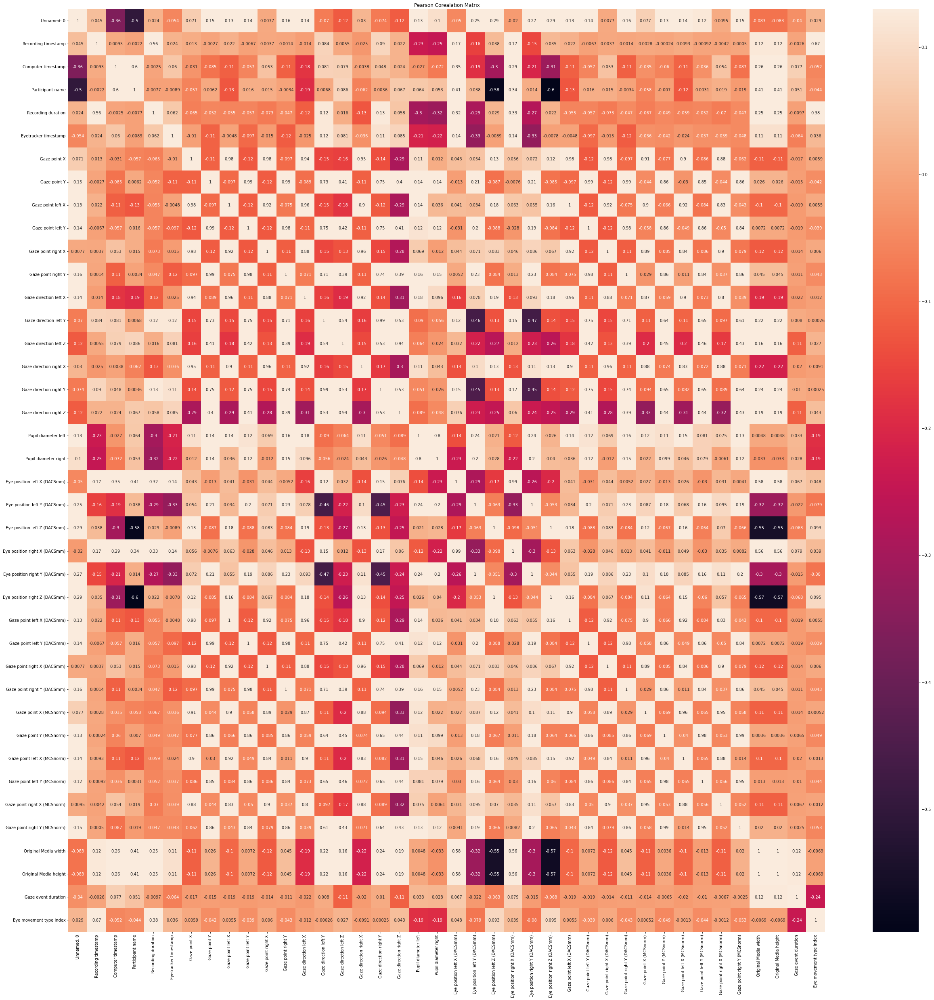

In [27]:
def drop_correlation(df):
    cor_matrix = df.drop('Empathy Score',axis=1).corr()
    plt.subplots(figsize = (42,42))
    plt.title('Pearson Corealation Matrix')
    sns.heatmap(cor_matrix,vmax = 0.13,annot=True)
    cor_col = set()
    for i in range(len(cor_matrix.columns)):
        for j in range(i):
            if abs(cor_matrix.iloc[i,j]) > .7 :
                col_n = cor_matrix.columns[i]
                cor_col.add(col_n)
    print('Coloums with Corelation are - ', cor_col)
    df  = df.drop(columns = cor_col, axis =1)
    return df
df = drop_correlation(df)